# **MINT JupyterLab**

First we are going to import Mint for Jupyter notebook with `from ms_mint.notebook import Mint` and display the GUI by calling `mint.show()`.

In [9]:
%pylab inline

rcParams['figure.facecolor'] = 'w'

from ms_mint.notebook import Mint
from glob import glob

mint = Mint()
mint.show()

Populating the interactive namespace from numpy and matplotlib


### Add MS-files

Then we add a number of mass-spec (MS) files either using the GUI or programmatically with the commands below. All we have to do is to provide a list of strings which are the absolute paths to the files.

In [10]:
PATH = '/data/MINT/MINT_demofiles/'
ms_files = glob(f'{PATH}/**/*mzXML', recursive=True)
mint.ms_files = ms_files

### Add peaklist

We also have to define a peaklist. This can be done using a filename or list of filenames and the `mint.peaklist_files` attribute. Or by assigning a `pandas.DataFrame()` to `mint.peaklist` directly.

In [6]:
mint.peaklist_files = '../tests/data/example_peaklist.csv'
mint.list_files()
mint.peaklist

,peak_label,mz_mean,mz_width,rt,rt_min,rt_max,intensity_threshold,peaklist_name
0,Arabitol,151.06050,10,None,4.65,5.20,0,example_peaklist.csv
1,Xanthine,151.02585,10,None,4.18,4.53,0,example_peaklist.csv
2,Succinate,117.01905,10,None,0.87,2.50,0,example_peaklist.csv
3,Urocanate,137.03540,10,None,4.30,4.60,0,example_peaklist.csv
4,Mevalonate,147.06570,10,None,1.70,4.30,0,example_peaklist.csv
5,M113,102.05562,10,None,7.70,8.10,0,example_peaklist.csv
6,DAS,331.23360,10,None,8.55,8.70,0,example_peaklist.csv
7,Nicotinate,122.02455,10,None,2.75,3.75,0,example_peaklist.csv
8,M106,131.07115,10,None,3.10,6.20,0,example_peaklist.csv
9,M41,152.99550,10,None,7.70,8.10,0,example_peaklist.csv


### `mint.run()`

This are the requirements to run Mint which can be done by calling the `mint.run()` method or by clicking the `Run` button in the GUI.


In [48]:
mint.run??

Signature: mint.run(b=None, **kwargs)
Docstring:
Run MINT with set up peaklist and ms-files.
----
Args
    - nthreads: int or None, default = None
        * None: Run with min(n_cpus, c_files) CPUs
        * 1: Run without multiprocessing on one CPU
        * >1: Run with multiprocessing enabled using nthreads threads.
    - mode: str, default = 'standard'
        * 'standard': calculates peak shaped projected to RT dimension
        * 'express': omits calculation of other features, only peak_areas
Source:   
    def run(self, b=None, **kwargs):
        self.progress = 0
        super(Mint, self).run(**kwargs)
        self.message('Done processing MS-files.')
        if self.results is not None:
            self.download_button.style.button_color = 'lightgreen'
File:      /mnt/c/Users/soere/workspace/ms-mint/ms_mint/notebook.py
Type:      method


# Export and load results

The results can be exported to a file and imported with `mint.export(filename)` and `mint.load(filename)`. This will also load the files and peaklist into memory. 

### `mint.export()`

In [10]:
mint.export('test-export.csv')

In [11]:
mint.export('test-export.xlsx')

### `mint.load()`

In [2]:
mint.load('test-export.csv')

# Display results

In [7]:
mint.run()

The generated results are stored in `mint.results`. The restuls are stored as a regular `pandas.Dataframe()`. The results dataframe has the following columns:

In [50]:
mint.results.columns.to_list()

['ms_file',
 'peak_label',
 'mz_mean',
 'mz_width',
 'rt',
 'rt_min',
 'rt_max',
 'intensity_threshold',
 'peaklist_name',
 'peak_area',
 'peak_n_datapoints',
 'peak_max',
 'peak_rt_of_max',
 'peak_min',
 'peak_median',
 'peak_mean',
 'peak_delta_int',
 'peak_shape_rt',
 'peak_shape_int',
 'peak_mass_diff_25pc',
 'peak_mass_diff_50pc',
 'peak_mass_diff_75pc',
 'peak_score',
 'total_intensity',
 'ms_path',
 'ms_file_size']

### `mint.results`

In [13]:
mint.results

,ms_file,peak_label,mz_mean,mz_width,rt,rt_min,rt_max,intensity_threshold,peaklist_name,peak_area,...,peak_delta_int,peak_shape_rt,peak_shape_int,peak_mass_diff_25pc,peak_mass_diff_50pc,peak_mass_diff_75pc,peak_score,total_intensity,ms_path,ms_file_size
0,CA_B1.mzXML,Arabitol,151.06050,10,NaN,4.65,5.20,0,example_peaklist.csv,1421677.0,...,656.0,"4.65,4.66,4.68,4.69,4.7,4.71,4.72,4.74,4.75,4....","6006,9870,14188,20467,35327,41981,46871,60581,...",2.330528,2.482045,2.633562,0.783208,25525758921,/data/MINT/MINT_demofiles/CA,12.731823
1,CA_B1.mzXML,Xanthine,151.02585,10,NaN,4.18,4.53,0,example_peaklist.csv,285156.0,...,7569.0,"4.18,4.19,4.21,4.22,4.23,4.24,4.26,4.27,4.28,4...","15925,12330,14286,15428,13416,10766,9708,8893,...",-0.414806,-0.212738,-0.111704,0.398478,25525758921,/data/MINT/MINT_demofiles/CA,12.731823
2,CA_B1.mzXML,Succinate,117.01905,10,NaN,0.87,2.50,0,example_peaklist.csv,11462137.0,...,3008.0,"0.88,0.89,0.9,0.91,0.93,0.94,0.95,0.96,0.98,0....","1628,2304,3359,2396,2706,3297,3185,3066,2173,2...",0.070309,0.200705,0.314801,0.684544,25525758921,/data/MINT/MINT_demofiles/CA,12.731823
3,CA_B1.mzXML,Urocanate,137.03540,10,NaN,4.30,4.60,0,example_peaklist.csv,45912.0,...,297.0,"4.31,4.32,4.33,4.34,4.36,4.37,4.38,4.39,4.41,4...","451,911,869,2694,5126,4307,4910,5561,2827,2801...",-0.693082,-0.331197,-0.108499,0.667353,25525758921,/data/MINT/MINT_demofiles/CA,12.731823
4,CA_B1.mzXML,Mevalonate,147.06570,10,NaN,1.70,4.30,0,example_peaklist.csv,10789.0,...,71.0,"1.76,1.77,1.91,1.92,2.06,2.09,2.13,2.16,2.2,2....","333,377,475,479,444,428,548,562,721,511,1240,4...",1.689628,2.104648,2.208403,0.415973,25525758921,/data/MINT/MINT_demofiles/CA,12.731823
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
94,EC_B4.mzXML,Nicotinate,122.02455,10,NaN,2.75,3.75,0,example_peaklist.csv,7098522.0,...,6105.0,"2.81,2.83,2.84,2.85,2.86,2.88,2.89,2.9,2.91,2....","666,3070,2510,5053,6483,13198,27003,40520,6184...",2.152832,2.324772,2.387295,0.686080,39302878955,/data/MINT/MINT_demofiles/EC,13.402552
95,EC_B4.mzXML,M106,131.07115,10,NaN,3.10,6.20,0,example_peaklist.csv,3986862.0,...,5993.0,"3.1,3.12,3.13,3.14,3.15,3.17,3.18,3.19,3.21,3....","2768,2595,2394,2356,2899,2438,2639,2219,3386,6...",1.992298,2.225130,2.341546,0.368515,39302878955,/data/MINT/MINT_demofiles/EC,13.402552
96,EC_B4.mzXML,M41,152.99550,10,NaN,7.70,8.10,0,example_peaklist.csv,6228.0,...,78.0,"7.97,7.98,7.99,8.0,8.02","710,1591,2643,652,632",2.983231,2.983231,3.082964,0.212841,39302878955,/data/MINT/MINT_demofiles/EC,13.402552
97,EC_B4.mzXML,M59,388.18725,10,NaN,4.70,5.00,0,example_peaklist.csv,521114.0,...,18839.0,"4.75,4.76,4.77,4.78,4.79,4.8,4.81,4.82,4.83,4....","20303,19703,63822,72657,75280,64372,61378,4940...",2.137716,2.294947,2.373563,0.469184,39302878955,/data/MINT/MINT_demofiles/EC,13.402552


### `mint.crosstab()`

In [55]:
mint.crosstab??

Signature: mint.crosstab(col_name='peak_area')
Docstring: <no docstring>
Source:   
    def crosstab(self, col_name='peak_area'):
        return pd.crosstab(self.results.ms_file, 
                           self.results.peak_label, 
                           self.results[col_name], 
                           aggfunc=sum).astype(np.float64)
File:      /mnt/c/Users/soere/workspace/ms-mint/ms_mint/Mint.py
Type:      method


The method `mint.crosstab()` uses the results to create cross-tables with the filenames as index and peak labels as column names. By default the values in `peak_max` are used. That can be changed by providing the name of the `col_name` argument.

In [8]:
mint.crosstab('peak_max')

peak_label,Arabitol,Citrulline,DAS,M106,M113,M41,M59,MS4,Mevalonate,Nicotinate,Succinate,Urocanate,Xanthine
ms_file,,,,,,,,,,,,,
CA_B1.mzXML,60581.0,15208.0,534.0,15573.0,2182.0,1532.0,64320.0,16486.0,1240.0,9073.0,781454.0,5561.0,15925.0
CA_B2.mzXML,33862.0,13242.0,NaN,15920.0,2403.0,1883.0,40907.0,19198.0,1320.0,21670.0,861603.0,7086.0,17566.0
CA_B3.mzXML,78222.0,11486.0,495.0,20994.0,2036.0,1446.0,70869.0,26681.0,1823.0,23892.0,1300881.0,10670.0,25280.0
CA_B4.mzXML,129437.0,11499.0,NaN,21467.0,2508.0,526.0,92153.0,25055.0,2092.0,16486.0,1273912.0,9444.0,25154.0
EC_B1.mzXML,1982.0,26708.0,591.0,86750.0,5970.0,3858.0,77931.0,NaN,3158.0,188951.0,76289728.0,4555.0,8406.0
EC_B2.mzXML,3400.0,16056.0,1362.0,153357.0,4005.0,5991.0,67058.0,10598.0,3067.0,180599.0,35901056.0,237427.0,2069.0
EC_B3.mzXML,3268.0,19076.0,784.0,73173.0,5509.0,2794.0,75889.0,NaN,2409.0,228134.0,68809656.0,2934.0,10516.0
EC_B4.mzXML,2679.0,32379.0,1411.0,34678.0,5677.0,2643.0,75280.0,NaN,2056.0,288399.0,59033956.0,4244.0,7962.0


In [56]:
mint.crosstab(col_name='peak_n_datapoints').fillna(0).astype(int)

peak_label,0_mz: 57.975_rt:4.3,100_mz:136.892_rt:4.8,101_mz:136.892_rt:13.8,102_mz:136.892_rt:13.1,103_mz:136.910_rt:4.7,104_mz:144.923_rt:11.9,105_mz:144.924_rt:0.7,106_mz:144.924_rt:13.1,107_mz:144.924_rt:15.0,108_mz:144.924_rt:3.3,...,91_mz:134.895_rt:5.5,92_mz:134.895_rt:13.1,93_mz:134.895_rt:13.8,94_mz:134.895_rt:6.0,95_mz:134.895_rt:0.7,96_mz:134.895_rt:5.7,97_mz:134.895_rt:4.3,98_mz:134.895_rt:5.9,99_mz:136.891_rt:12.0,9_mz: 89.024_rt:6.3
ms_file,,,,,,,,,,,,,,,,,,,,,
CA_B1.mzXML,17,43,0,0,19,6,12,0,0,40,...,17,0,0,16,28,17,21,11,12,69
CA_B2.mzXML,16,47,0,0,20,7,12,0,0,40,...,15,0,0,22,27,16,20,10,14,67
CA_B3.mzXML,18,43,0,0,20,6,12,0,0,43,...,16,0,0,16,28,16,22,10,12,69
CA_B4.mzXML,18,40,0,0,22,6,12,0,0,42,...,16,0,0,15,28,17,23,9,12,69
EC_B1.mzXML,18,98,72,124,8,7,12,73,6,42,...,16,63,35,14,29,17,22,10,6,72
EC_B2.mzXML,17,96,70,124,9,6,12,72,6,42,...,16,63,35,15,30,17,21,10,7,69
EC_B3.mzXML,20,96,70,124,8,7,12,72,6,42,...,16,63,35,15,28,17,22,10,7,69
EC_B4.mzXML,20,98,70,126,8,6,12,73,6,42,...,16,63,35,15,29,17,23,10,6,69


This makes it easy to calculate the correlation between different metabolites across different samples. And exploid all the pandas function in general.

In [9]:
mint.crosstab('peak_max').corr()

peak_label,Arabitol,Citrulline,DAS,M106,M113,M41,M59,MS4,Mevalonate,Nicotinate,Succinate,Urocanate,Xanthine
peak_label,,,,,,,,,,,,,
Arabitol,1.000000,-0.679379,-0.636534,-0.597033,-0.764526,-0.762334,0.305777,0.825961,-0.465895,-0.795133,-0.777083,-0.281839,0.890395
Citrulline,-0.679379,1.000000,0.472534,0.212620,0.862412,0.359895,0.206783,-0.974627,0.394409,0.845258,0.811148,-0.137434,-0.640862
DAS,-0.636534,0.472534,1.000000,0.488985,0.427193,0.601775,0.031364,-0.803785,0.343072,0.710190,0.335558,0.574296,-0.731544
M106,-0.597033,0.212620,0.488985,1.000000,0.517298,0.948948,0.111785,-0.741687,0.860522,0.556203,0.557686,0.819188,-0.789671
M113,-0.764526,0.862412,0.427193,0.517298,1.000000,0.550934,0.320640,-0.761241,0.692791,0.941462,0.990087,0.026008,-0.740040
M41,-0.762334,0.359895,0.601775,0.948948,0.550934,1.000000,-0.106142,-0.830698,0.761186,0.614747,0.578396,0.791411,-0.891637
M59,0.305777,0.206783,0.031364,0.111785,0.320640,-0.106142,1.000000,0.382979,0.466240,0.258337,0.314496,-0.095128,0.093318
MS4,0.825961,-0.974627,-0.803785,-0.741687,-0.761241,-0.830698,0.382979,1.000000,-0.400164,-0.735725,-0.760844,-0.757962,0.971455
Mevalonate,-0.465895,0.394409,0.343072,0.860522,0.692791,0.761186,0.466240,-0.400164,1.000000,0.629691,0.724027,0.512030,-0.621361


Text(0.5, 1.0, 'Skewness of log transformed peak maxima.')

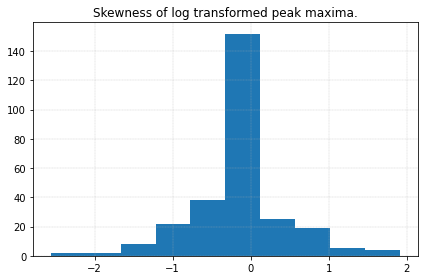

In [62]:
mint.crosstab('peak_max').apply(log1p).skew().hist()
title('Skewness of log transformed peak maxima.')

# Plot results

Further build in plotting tools are `mint.plot_clustering()`, `mint.plot_heatmap()`, and `mint.plot_peak_shapes()`.

### `mint.plot_clustering()`

In [3]:
print(mint.plot_clustering.__doc__)


        Performs a cluster analysis and plots a heatmap. If no data is provided, 
        data is taken form self.crosstab(target_var).
        First the data is transformed with the transform function (default is log(x+1)).
        If normalize_by_row==True the (transformed) data is also row-normalized (z=(x-μ)/σ)).
        A hierachical cluster analysis is performed with the (transformed) data.
        The original data is then re-ordered accoring to the resulting clusters.
        The result is stored in self.clustered.
        


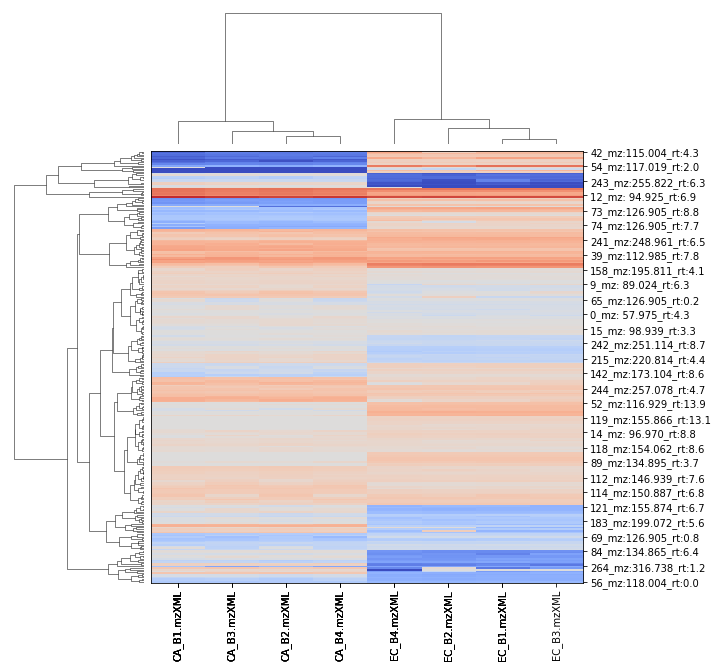

In [64]:
mint.plot_clustering(target_var='peak_area')

The untransformed data in clustered order is stored in `mint.clustered`.

In [20]:
mint.clustered

peak_label,MS4,Citrulline,Xanthine,Urocanate,Arabitol,Nicotinate,M106,M59,Mevalonate,M41,M113,DAS,Succinate
ms_file,,,,,,,,,,,,,
CA_B1.mzXML,16486.0,15208.0,15925.0,5561.0,60581.0,9073.0,15573.0,64320.0,1240.0,1532.0,2182.0,534.0,781454.0
CA_B3.mzXML,26681.0,11486.0,25280.0,10670.0,78222.0,23892.0,20994.0,70869.0,1823.0,1446.0,2036.0,495.0,1300881.0
CA_B2.mzXML,19198.0,13242.0,17566.0,7086.0,33862.0,21670.0,15920.0,40907.0,1320.0,1883.0,2403.0,NaN,861603.0
CA_B4.mzXML,25055.0,11499.0,25154.0,9444.0,129437.0,16486.0,21467.0,92153.0,2092.0,526.0,2508.0,NaN,1273912.0
EC_B2.mzXML,10598.0,16056.0,2069.0,237427.0,3400.0,180599.0,153357.0,67058.0,3067.0,5991.0,4005.0,1362.0,35901056.0
EC_B4.mzXML,NaN,32379.0,7962.0,4244.0,2679.0,288399.0,34678.0,75280.0,2056.0,2643.0,5677.0,1411.0,59033956.0
EC_B1.mzXML,NaN,26708.0,8406.0,4555.0,1982.0,188951.0,86750.0,77931.0,3158.0,3858.0,5970.0,591.0,76289728.0
EC_B3.mzXML,NaN,19076.0,10516.0,2934.0,3268.0,228134.0,73173.0,75889.0,2409.0,2794.0,5509.0,784.0,68809656.0


The clustering tools are available in the `ms_mint.vis` module.

Index(['MS4', 'Citrulline', 'Xanthine', 'Urocanate', 'Arabitol', 'Nicotinate',
       'M106', 'M59', 'Mevalonate', 'M41', 'M113', 'DAS', 'Succinate'],
      dtype='object', name='peak_label')


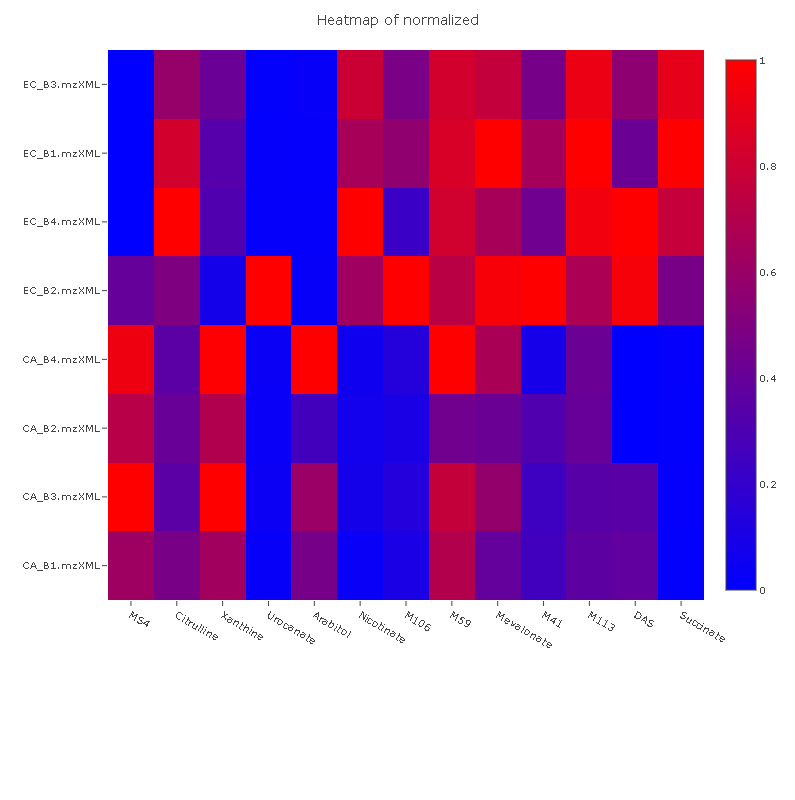

In [30]:
from ms_mint.vis.plotly.plotly_tools import plot_heatmap
plot_heatmap(mint.clustered, normed_by_cols=True)

### `mint.plot_heatmap()`

In [2]:
print(mint.plot_heatmap.__doc__)


        `mint.plot_heatmap()` creates an interactive heatmap 
        that can be used to explore the data interactively.
        `mint.crosstab()` is called and then subjected to
        the `mint.vis.plotly.plotly_tools.plot_heatmap()`.

        Args
        ----
        * col_name
        * normed_by_cols: bool, default=True
            Whether or not to normalize the columns in the crosstab.
        * target_var: str, default='peak_area', 
        * clustered: bool, default=False
            Whether or not to cluster the rows. 
        * add_dendrogram: bool, default=False
            Whether or not to replace row labels with a dendrogram.
        * transposed: bool, default=False
            If True transpose matrix before plotting.
        * correlation: bool, default=False
            If True convert data to correlation matrix before plotting.

        


Index(['Arabitol', 'Citrulline', 'DAS', 'M106', 'M113', 'M41', 'M59', 'MS4',
       'Mevalonate', 'Nicotinate', 'Succinate', 'Urocanate', 'Xanthine'],
      dtype='object', name='peak_label')


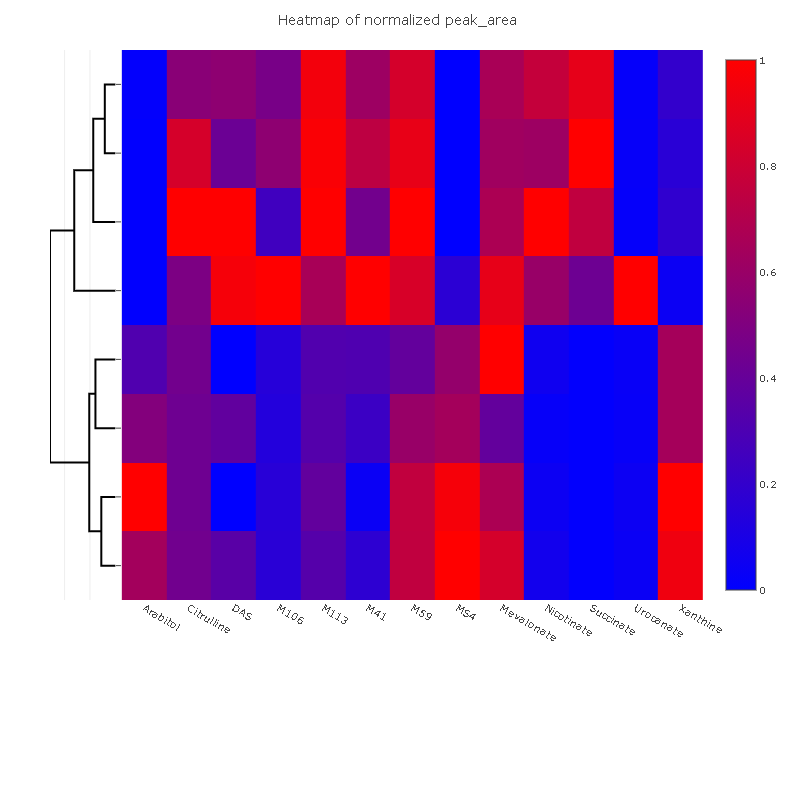

In [12]:
mint.plot_heatmap(normed_by_cols=True, target_var='peak_area', clustered=True, add_dendrogram=True)

### `mint.plot_peak_shapes()`

In [4]:
print(mint.plot_peak_shapes.__doc__)

None


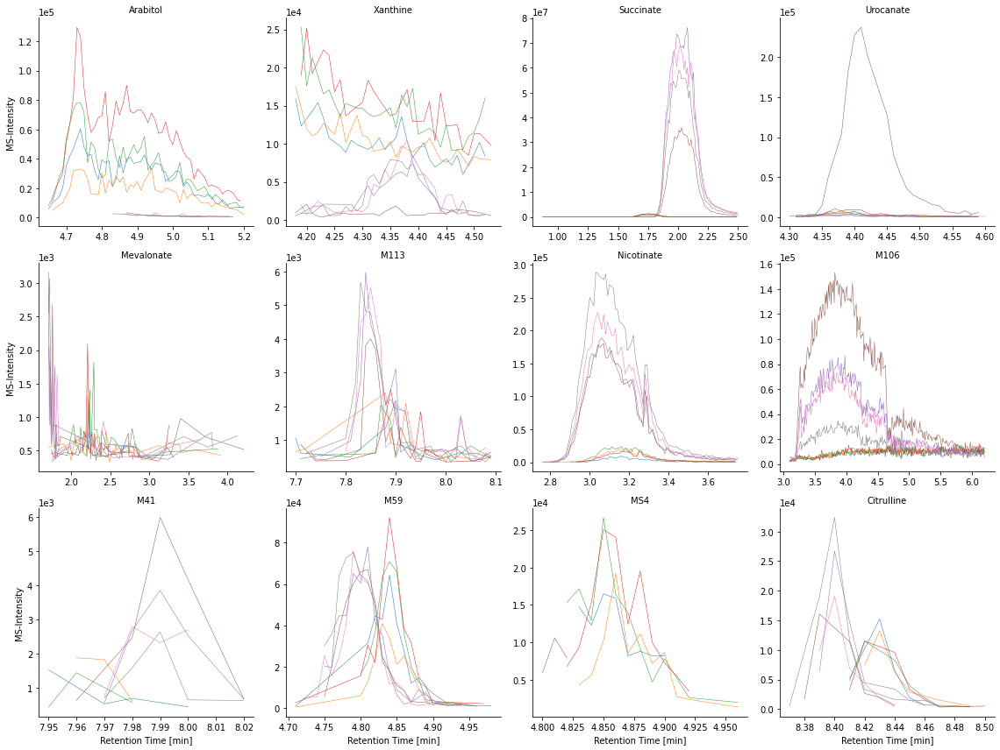

In [44]:
mint.plot_peak_shapes()

# Peak optimization

### `mint.optimize_retention_times()`

In [5]:
print(mint.optimize_retention_times.__doc__)

None


Optimize RT


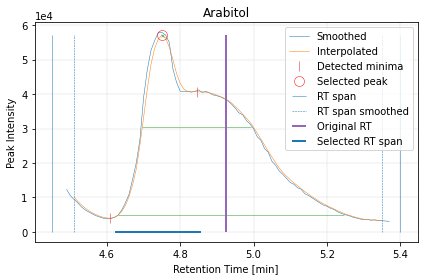

Smoothed to small
Smoothed to small


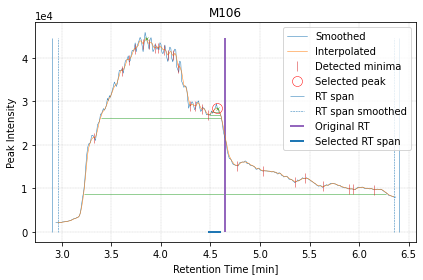

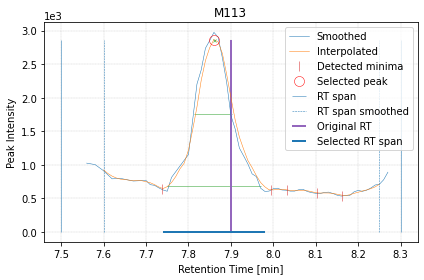

Smoothed to small


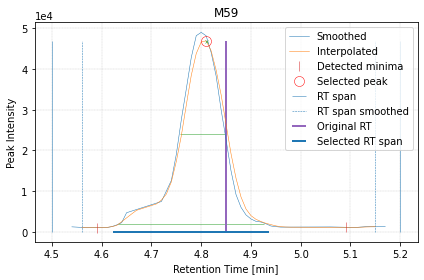

Smoothed to small
No peaks found.


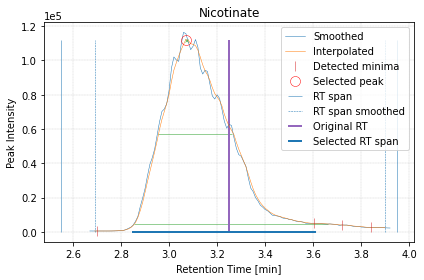

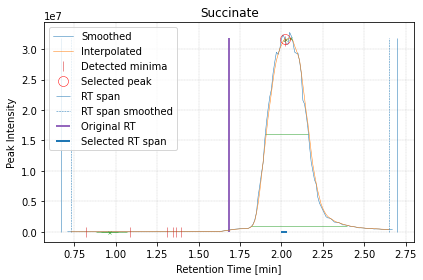

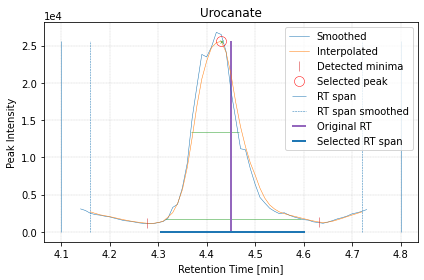

No peaks found.


,peak_label,mz_mean,mz_width,rt,rt_min,rt_max,intensity_threshold,peaklist_name
0,Arabitol,151.06050,10,4.925,4.621,4.856,0,example_peaklist
1,Xanthine,151.02585,10,4.355,3.980,4.730,0,example_peaklist
2,Succinate,117.01905,10,1.685,1.997,2.033,0,example_peaklist
3,Urocanate,137.03540,10,4.450,4.303,4.604,0,example_peaklist
4,Mevalonate,147.06570,10,3.000,1.500,4.500,0,example_peaklist
5,M113,102.05562,10,7.900,7.740,7.982,0,example_peaklist
6,DAS,331.23360,10,8.625,8.350,8.900,0,example_peaklist
7,Nicotinate,122.02455,10,3.250,2.844,3.612,0,example_peaklist
8,M106,131.07115,10,4.650,4.477,4.607,0,example_peaklist
9,M41,152.99550,10,7.900,7.500,8.300,0,example_peaklist


In [3]:
mint.optimize_retention_times(show_plots=True)

# Peak detection

Peak detection is an experimental feature and only available in the Jupyter implementation and not yet in the browser based GUI. We use `FeatureFindingMetabo` class from the `pyopenms`.
After peak detection the identified peaks are added to `mint.peaklist` as new rows. We recommend filtering the peaks by the calculated `peak_score` in `mint.results` after running mint to remove features that do not have a good intensity profile. 

### `mint.detect_peaks()`

In [11]:
print(mint.detect_peaks.__doc__)

None


In [12]:
mint.reset()

mint.ms_files = ms_files

mint.detect_peaks()

mint.peaklist

,peak_label,mz_mean,mz_width,rt,rt_min,rt_max,intensity_threshold,peaklist_name
0,0_mz: 57.975_rt:4.3,57.975390,10,4.340858,4.179968,4.517265,0,OMS
1,1_mz: 61.988_rt:4.8,61.988116,10,4.830475,4.567823,5.061977,0,OMS
2,2_mz: 73.030_rt:2.0,73.029552,10,2.045731,1.751525,2.336558,0,OMS
3,3_mz: 82.954_rt:0.7,82.953983,10,0.741317,0.612395,0.870239,0,OMS
4,4_mz: 82.954_rt:4.8,82.953998,10,4.793792,4.671236,4.905168,0,OMS
...,...,...,...,...,...,...,...,...
272,272_mz:356.146_rt:4.8,356.145680,10,4.787250,4.734476,4.840024,0,OMS
273,273_mz:374.906_rt:6.5,374.905875,10,6.523283,6.224014,6.822553,0,OMS
274,274_mz:384.936_rt:6.5,384.935541,10,6.513467,6.186772,6.867964,0,OMS
275,275_mz:387.114_rt:7.6,387.113806,10,7.635371,7.553819,7.715843,0,OMS


In [13]:
mint.run()

Text(0.5, 0, '<peak_score>')

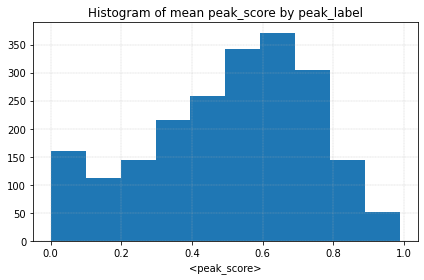

In [14]:
mint.results.peak_score.hist()
title('Histogram of mean peak_score by peak_label')
xlabel('<peak_score>')

Now we are going to calculate the mean score per peak-label and print the peak shapes in descending order (best peaks first). This may last a while.

In [41]:
peak_labels_by_mean_score = mint.results.groupby('peak_label').mean()['peak_score'].sort_values(ascending=False)

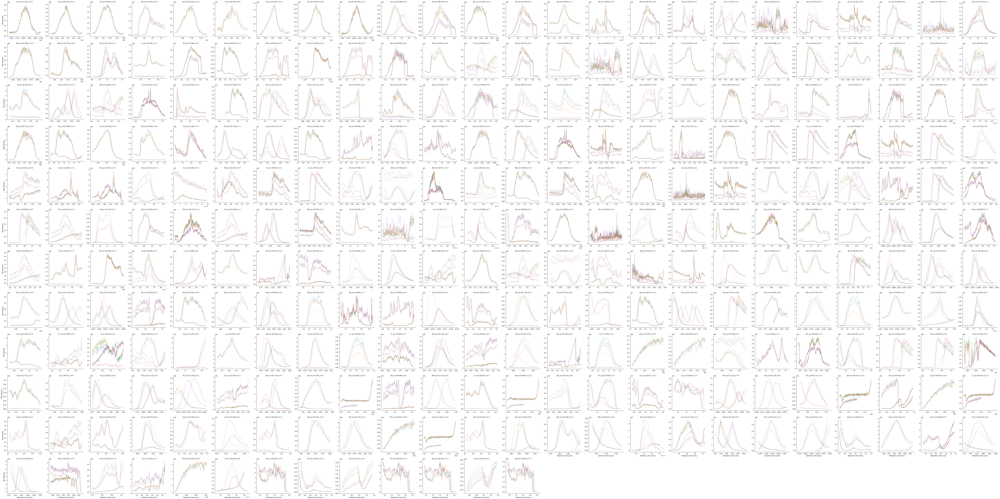

In [42]:
mint.plot_peak_shapes(peak_labels=peak_labels_by_mean_score.index, col_wrap=24)

Optimize RT


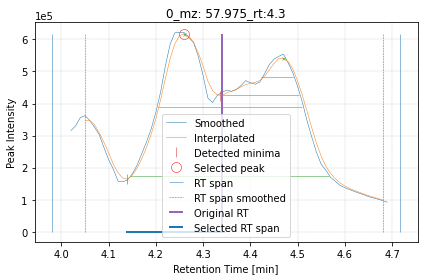

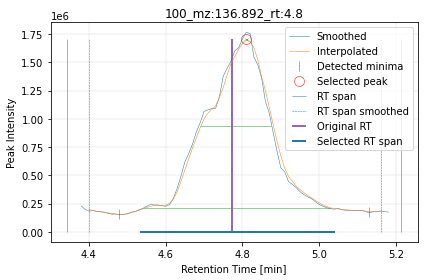

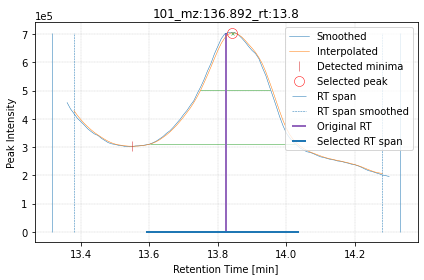

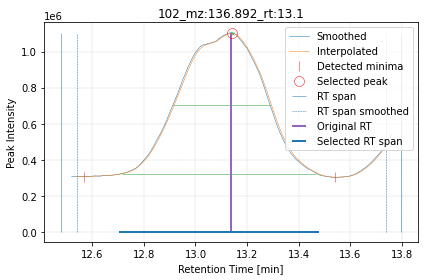

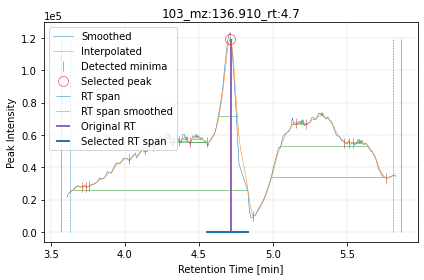

...

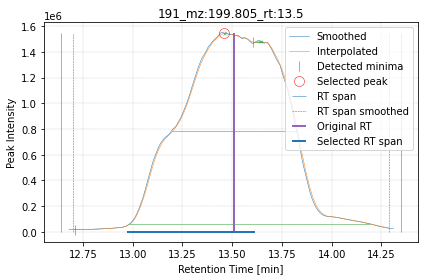

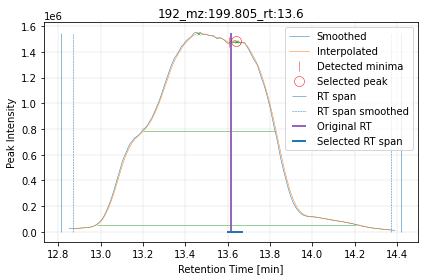

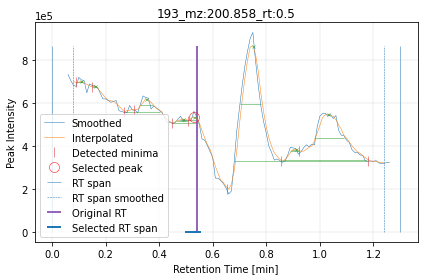

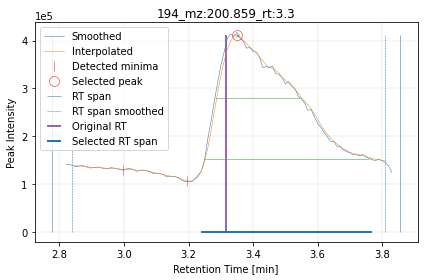

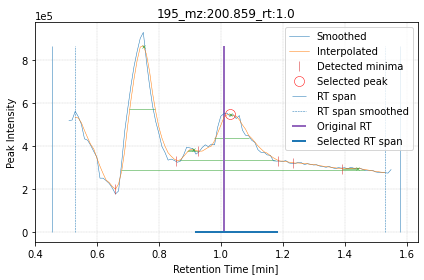

No peaks found.


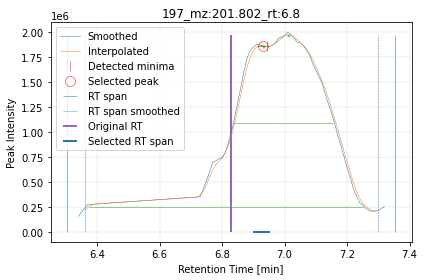

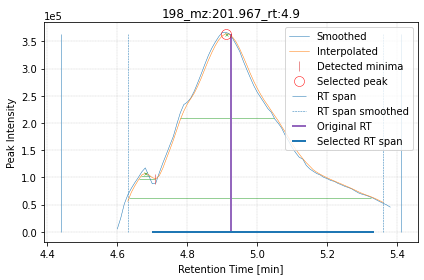

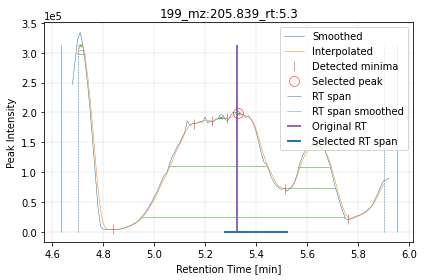

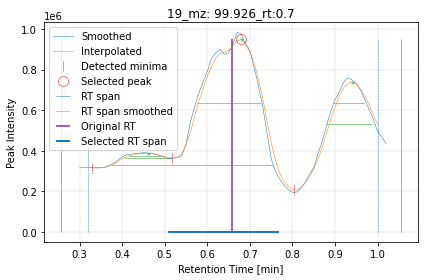

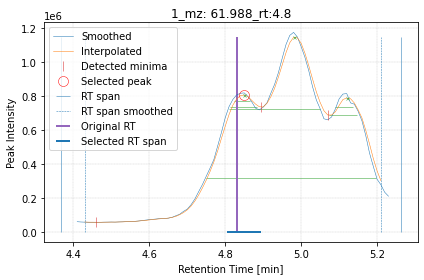

...

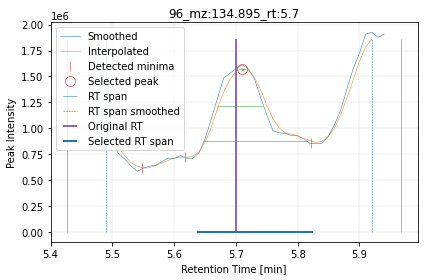

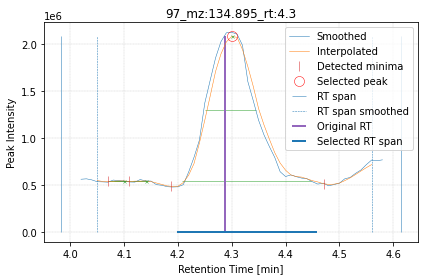

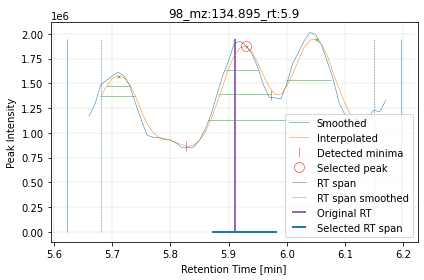

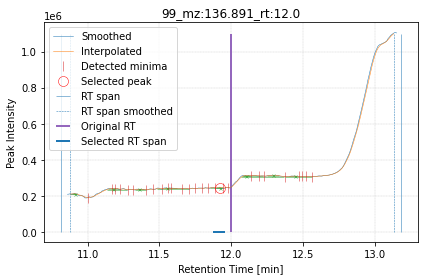

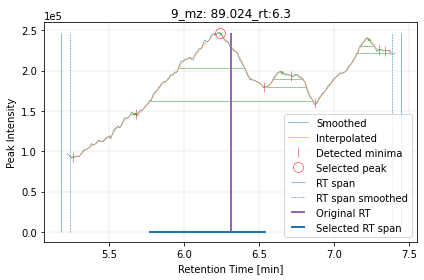

,peak_label,mz_mean,mz_width,rt,rt_min,rt_max,intensity_threshold,peaklist_name
0,0_mz: 57.975_rt:4.3,57.975390,10,4.340858,4.136,4.345,0,OMS
1,1_mz: 61.988_rt:4.8,61.988116,10,4.830475,4.803,4.894,0,OMS
2,2_mz: 73.030_rt:2.0,73.029552,10,2.045731,2.015,2.398,0,OMS
3,3_mz: 82.954_rt:0.7,82.953983,10,0.741317,0.678,0.909,0,OMS
4,4_mz: 82.954_rt:4.8,82.953998,10,4.793792,4.697,5.010,0,OMS
...,...,...,...,...,...,...,...,...
272,272_mz:356.146_rt:4.8,356.145680,10,4.787250,4.680,4.716,0,OMS
273,273_mz:374.906_rt:6.5,374.905875,10,6.523283,6.241,6.879,0,OMS
274,274_mz:384.936_rt:6.5,384.935541,10,6.513467,6.248,6.942,0,OMS
275,275_mz:387.114_rt:7.6,387.113806,10,7.635371,7.469,7.719,0,OMS


In [43]:
mint.optimize_retention_times(show_plots=False)

In [44]:
mint.run()

In [46]:
peak_labels_by_mean_score =mint.results.groupby('peak_label').mean()['peak_score'].sort_values(ascending=False)

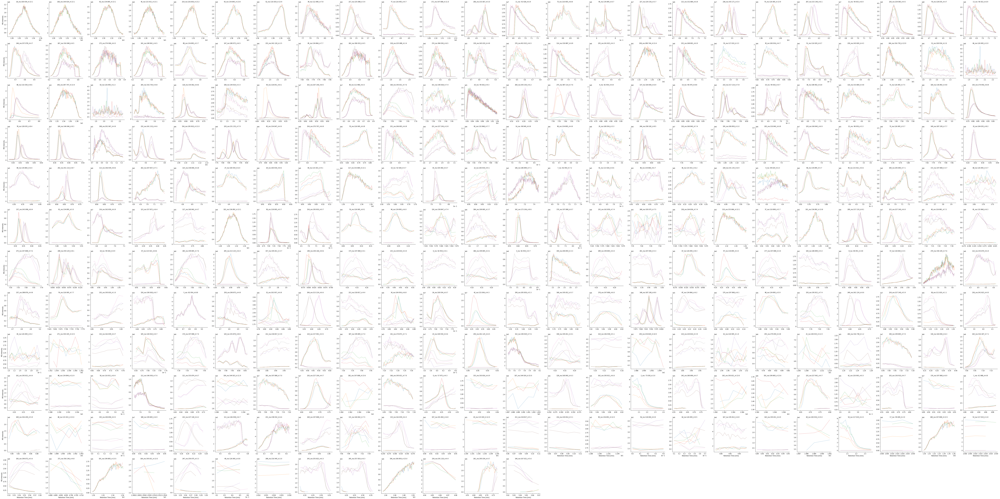

In [47]:
mint.plot_peak_shapes(peak_labels=peak_labels_by_mean_score.index, col_wrap=24)